In [167]:
import numpy as np
import  utils
import matplotlib.pyplot as plt
from math import exp, sqrt
from scipy.signal import lfilter
from scipy.stats import  norm
from scipy.optimize import root as root_finder
import matplotlib.animation as animation
import time
from IPython.display import  HTML

In [168]:
# 1/24 = 1 week. 1Y = 6M | 1M = 4W --> 1Y = 24W
# 1/240 = 1/2 bday. 1W = 5 bdays
k, sigma, T, delta, dt  = 0.015, 0.025, 5, 1/24, 1/240 #sigma = 0.01
C1, C2, C3              = 0.15, -0.03, -0.18 # C1 = 0.05
r0                      = utils.obs_yield_curve(0, C1, C2, C3)
notional                = 10000

time_grid   = np.arange(0, T+dt, dt)
dfixing     = 0.25
fixing_grid = np.arange(T+dfixing, T+5+dfixing, dfixing)
N           = len(time_grid)-1
M           = 10000
tref        = 1 # 1/12 : 1 month
ind_tref, ind_delta, ind_tdelta = int(tref/dt), int(delta/dt), int((tref+delta)/dt)
alpha       = 0.99
R           = 0.04

In [169]:
rf_paths = utils.gen_riskfactors(r0, k, sigma, C1, C2, C3, dt, M, time_grid)

In [170]:
zc1_mtm_paths = utils.gen_zc_mtm(rf_paths, k, sigma, C1, C2, C3, T, time_grid)

In [171]:
swaption_mtm_paths = utils.gen_mtm(rf_paths, k, sigma, R, C1, C2, C3, dt, T, time_grid, fixing_grid, notional)

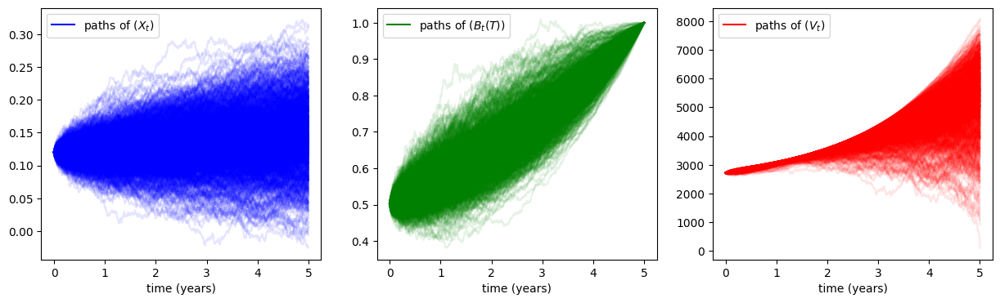

In [172]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))
axs[0].plot(time_grid, rf_paths.T[:, :1000], alpha=0.1, color='blue')
axs[0].plot([None], [None], color='blue', label='paths of $(X_t)$')
axs[0].set_xlabel('time (years)')
axs[0].legend()
axs[1].plot(time_grid, zc1_mtm_paths.T[:, :1000], alpha=0.1, color='green')
axs[1].plot([None], [None], color='green', label='paths of $(B_t(T))$')
axs[1].set_xlabel('time (years)')
axs[1].legend()
axs[2].plot(time_grid, swaption_mtm_paths.T[:, :1000], alpha=0.1, color='red')
axs[2].plot([None], [None], color='red', label='paths of $(V_t)$')
axs[2].set_xlabel('time (years)')
axs[2].legend()
plt.show()

In [173]:
rt_vals = np.linspace(-0.2, 0.2, 1000)
rt_vals_full = np.repeat(rt_vals.reshape(-1, 1), len(time_grid), axis=1)
swaption_mtm = utils.gen_mtm(rt_vals_full, k, sigma, R, C1, C2, C3, dt, T, time_grid, fixing_grid, notional)

In [174]:
def mean(t):
    return r0 * np.exp(-k*t) + utils.beta(t, k, sigma, C1, C2, C3) - utils.beta(0, k, sigma, C1, C2, C3) * np.exp(-k*t)

def variance(t):
    return (sigma**2 / (2*k)) * (1 - np.exp(-2*k*t))

pdf_vals = norm.pdf(rt_vals, loc=mean(time_grid).reshape(-1, 1), scale=np.sqrt(variance(time_grid)).reshape(-1, 1)).T
pdf_vals[:, 0] = 0

c:\Users\CF518AW\OneDrive - EY\Documents\STAGE\EY-Initial-Margin\.venv\Lib\site-packages\scipy\stats\_distn_infrastructure.py:2046: RuntimeWarning: divide by zero encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


In [175]:
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
u = ax.plot(rt_vals, swaption_mtm[:, 0], label='$u(t, r)$')[0]
v = ax.plot(rt_vals, pdf_vals[:, 0], label='pdf of $r_t$')[0]
rtime_grid = time_grid[::2]
rswaption_mtm = swaption_mtm[:, ::2]
rpdf_vals = pdf_vals[:, ::2] * 10
ax.set_title(f"t = {rtime_grid[0]:.2f}")
ax.grid()
ax.set_xlabel("$r$")
ax.set_ylim(np.min(rswaption_mtm), np.max(rswaption_mtm))

def update(n):
    u.set_ydata(rswaption_mtm[:, n])
    v.set_ydata(rpdf_vals[:, n] * 10)
    ax.set_title(f"t = {rtime_grid[n]:.2f}")
    return [u]

video = animation.FuncAnimation(fig, update, frames=len(rtime_grid), blit=True, interval=100, repeat=False)
plt.close(fig)
HTML(video.to_jshtml())